### Deep Convolutional Generative Adversarial Network 

#### Setting up tensorflow to run on GPU

In [1]:
import tensorflow as tf
print("Num GPUs Available: ", len(tf.config.experimental.list_physical_devices('GPU')))

Num GPUs Available:  1


In [2]:
tf.__version__

'2.3.0'

In [6]:
# To generate GIFs
!pip install imageio
!pip install git+https://github.com/tensorflow/docs

     |████████████████████████████████| 3.3 MB 7.2 MB/s eta 0:00:01
You should consider upgrading via the '/usr/bin/python3 -m pip install --upgrade pip' command.
  Cloning https://github.com/tensorflow/docs to /tmp/pip-req-build-3ca2ev04
  Running command git clone -q https://github.com/tensorflow/docs /tmp/pip-req-build-3ca2ev04
     |████████████████████████████████| 269 kB 9.0 MB/s eta 0:00:01
  Created wheel for tensorflow-docs: filename=tensorflow_docs-0.0.0146903589e869081cce7006f160331ea5837418c_-py3-none-any.whl size=137081 sha256=56a20ac9d443e935a71494c65eae7947fdfd84bf2f586882fd2be53f88e11c5c
  Stored in directory: /tmp/pip-ephem-wheel-cache-5vpit4_5/wheels/27/ca/30/9fb73780f8e8eb5a8321ae35616b0e9609f33e6c6f4071e8dd
  Created wheel for pyyaml: filename=PyYAML-5.3.1-cp36-cp36m-linux_x86_64.whl size=45919 sha256=07786e11dd69486ed105238f3d3f6941e37359deafe52e427fd2c0d1741d7e10
  Stored in directory: /root/.cache/pip/wheels/e5/9d/ad/2ee53cf262cba1ffd8afe1487eef788ea3f260b7e6232a

In [3]:
#Other libraries we need to import
import glob
import imageio
import matplotlib.pyplot as plt
import numpy as np
import os
import PIL
from tensorflow.keras import layers
import time
import pathlib

from IPython import display

In [4]:
!nvcc --version

nvcc: NVIDIA (R) Cuda compiler driver
Copyright (c) 2005-2019 NVIDIA Corporation
Built on Sun_Jul_28_19:07:16_PDT_2019
Cuda compilation tools, release 10.1, V10.1.243


### Input pipeline of tensorflow

In [5]:
# function to process and transform image
def process_image(file_name):
    
    # load the raw data from the file as a string
    img = tf.io.read_file(file_name)
    
    # convert the compressed string to a 3D uint8 tensor
    img = tf.image.decode_jpeg(img, channels=3)
    
    # resize the image to the desired size
    img = tf.image.resize(img, [img_height, img_width])
  
    # normalizing image vector
    img = (img - 127.5)/127.5 # scaling to the range of the tanh activation function [-1, 1]
    
    return img

In [6]:
# function of input pipeline to tensorflow training
def input_pipeline(data_dir, img_height, img_width, batch_size):
    
    # handling path with pathlib
    data_dir = pathlib.Path(data_dir)

    # getting path of all files
    list_ds = tf.data.Dataset.list_files(str(data_dir/'*'), shuffle=False)
    
    # shuffling before map
    buffer_size = len(list_ds) # buffer_size should be total no. of images in dataset to be well shuffled
    list_ds = list_ds.shuffle(buffer_size) # shuffling filenames
    
    # parallel processing of the images using dataset.map() and AUTOTUNE parallel calls
    AUTOTUNE = tf.data.experimental.AUTOTUNE
    train_ds = list_ds.map(process_image, num_parallel_calls=AUTOTUNE)
    
    # getting data in batches of batch_size
    train_ds = train_ds.batch(batch_size)
    
    # caching the dataset 
    train_ds = train_ds.cache()
    
    # prefetching the dataset 
    train_ds = train_ds.prefetch(buffer_size=AUTOTUNE)
    
    return train_ds

In [7]:
'''Running input pipeline on CPU:

Input arguments: 
1. data_dir: directory of images datasets
2. img_height: height of the image for resizing
3. img_width: width of the image for resizing
4. batch_size: batch size of the images to batched during training

Return: 
train_ds: training_dataset for DCGANs model

'''
#data_dir = '/home/santosh/Documents/dcgan_anime_faces/anime_faces/'
data_dir = 'anime_faces/' # this is when using docker
img_height = 64
img_width = 64
batch_size = 128

# putting data processing pipeline on CPU to make sure that GPU is used only for training NN 
with tf.device('/cpu:0'):
    train_ds = input_pipeline(data_dir, img_height, img_width, batch_size)

In [8]:
imgs = next(iter(train_ds))

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


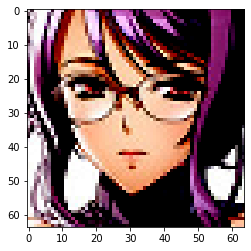

In [9]:
plt.imshow(imgs[1])

## Create the models

Both the generator and discriminator are defined using the [Keras Sequential API](https://www.tensorflow.org/guide/keras#sequential_model).

### The Generator

The generator uses `tf.keras.layers.Conv2DTranspose` (upsampling) layers to produce an image from a seed (random noise). Start with a `Dense` layer that takes this seed as input, then upsample several times until you reach the desired image size of 28x28x1. Notice the `tf.keras.layers.LeakyReLU` activation for each layer, except the output layer which uses tanh.

In [10]:
# function for generator 
def make_generator_model():

    # creating sequential model
    model = tf.keras.Sequential()
    
    # dense layer that takes input shape of (None, 100)
    model.add(layers.Dense(4*4*1024, use_bias=False, input_shape=(100,))) 
    model.add(layers.BatchNormalization()) # batch normalization on dense NN layer
    model.add(layers.ReLU()) # ReLu activation function  

    model.add(layers.Reshape((4, 4, 1024))) # reshaping the dimensions
    assert model.output_shape == (None, 4, 4, 1024) # Note: None is the batch size and we are asserting on output shape

    # Transposed convolution layer 1 with 512 filters, kernel size of (5,5), and kernal stride of 2 with padding 'same' 
    model.add(layers.Conv2DTranspose(512, (5, 5), strides=(2, 2), padding='same', use_bias=False)) 
    assert model.output_shape == (None, 8, 8, 512)
    model.add(layers.BatchNormalization()) # batch normalization on 2D convolution layer
    model.add(layers.ReLU()) # relu activation

    # Transposed convolution layer 2 with 256 filters, kernel size of (5,5), and stride of 2 with padding 'same' 
    model.add(layers.Conv2DTranspose(256, (5, 5), strides=(2, 2), padding='same', use_bias=False))
    assert model.output_shape == (None, 16, 16, 256) # assertion on output
    model.add(layers.BatchNormalization()) # batch normalization
    model.add(layers.ReLU()) # ReLu activation function

    # Transposed convolution layer 3 with 128 filter, kernel size of (5,5), stride of 2 with padding 'same'
    model.add(layers.Conv2DTranspose(128, (5, 5), strides=(2, 2), padding='same', use_bias=False))
    assert model.output_shape == (None, 32, 32, 128) # assertion on output
    model.add(layers.BatchNormalization()) # batch normalization
    model.add(layers.ReLU()) # ReLu activation function
    
    # Transposed convolution layer 4 with 3 filters, kernel size (5,5), stride of 2 with 'same' padding and activation tanh
    model.add(layers.Conv2DTranspose(3, (5, 5), strides=(2, 2), padding='same', use_bias=False, activation='tanh'))
    assert model.output_shape == (None, 64, 64, 3)
    return model

Use the (as yet untrained) generator to create an image.

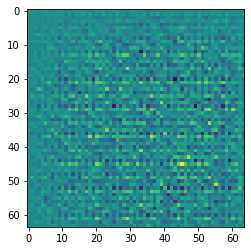

In [11]:
# creating image using untrained generator

# creating instance of generator
generator = make_generator_model()

# noisy image with random input with normal distribution
noise = tf.random.normal([1, 100])

# generating image using generator that is not trained yet
generated_image = generator(noise, training=False)

# showing image as grayscale
plt.imshow(generated_image[0, :, :, 0])

### The Discriminator

The discriminator is a CNN-based image classifier.

In [17]:
# function for discriminator
def make_discriminator_model():

    # creating sequential model
    model = tf.keras.Sequential()

    # 2D convolutional layer 1 with 64 filters, kernel of (4, 4), stride of 2, padding 1 and input shape of (64, 64, 3)
    model.add(layers.Conv2D(64, (4, 4), strides=(2, 2), padding='same', input_shape=[64, 64, 3], use_bias=False))
    model.add(layers.LeakyReLU(alpha=0.2)) # leaky relu with negative slope 0.2
    #model.add(layers.Dropout(0.3)) # dropout with probability 0.3 for regularization

    # 2D convolutional layer 2 with 128 filters, kernel of (4, 4), stride of 2, and padding of 1
    model.add(layers.Conv2D(128, (4, 4), strides=(2, 2), padding='same'))
    model.add(layers.BatchNormalization())
    model.add(layers.LeakyReLU(alpha=0.2)) # leaky relu with negative slope 0.2
    #model.add(layers.Dropout(0.3)) # dropout with prob 0.3 for regularization

    # 2D convolutional layer 3 with 256 filters, kernel of (4, 4), stride of 2 and padding of 1
    model.add(layers.Conv2D(256, (4,4), strides=(2,2), padding='same'))
    model.add(layers.BatchNormalization())
    model.add(layers.LeakyReLU(alpha=0.2))
    #model.add(layers.Dropout(0.3))
    
    #2D convolutional layer 4
    model.add(layers.Conv2D(512, (4,4), strides=(2,2), padding='same'))
    model.add(layers.BatchNormalization())
    model.add(layers.LeakyReLU(alpha=0.2))
    #model.add(layers.Dropout(0.3))
    
    model.add(layers.Flatten())  # flattening the output of previous layer
    model.add(layers.Dense(1)) # dense layer with 1 unit

    return model

Use the (as yet untrained) discriminator to classify the generated images as real or fake. The model will be trained to output positive values for real images, and negative values for fake images.

#### Creating instance of discriminator

In [18]:
discriminator = make_discriminator_model() # creating discriminator object
decision = discriminator(generated_image) # classification on generated image
print(decision) # printing decision

tf.Tensor([[-0.0002713]], shape=(1, 1), dtype=float32)


## Define the loss and optimizers

Define loss functions and optimizers for both models.


In [19]:
# This method returns a helper function to compute cross entropy loss
cross_entropy = tf.keras.losses.BinaryCrossentropy(from_logits=True)

### Discriminator loss

This method quantifies how well the discriminator is able to distinguish real images from fakes. It compares the discriminator's predictions on real images to an array of 1s, and the discriminator's predictions on fake (generated) images to an array of 0s.

In [20]:
def discriminator_loss(real_output, fake_output):

    # comparing real_output with array of 1 to compute real loss using cross entropy loss function
    real_loss = cross_entropy(tf.ones_like(real_output), real_output)

    # comparing fake_output with array of 1 to compute fake loss using cross entropy loss function
    fake_loss = cross_entropy(tf.zeros_like(fake_output), fake_output)

    # total loss
    total_loss = real_loss + fake_loss
    return total_loss

### Generator loss
The generator's loss quantifies how well it was able to trick the discriminator. Intuitively, if the generator is performing well, the discriminator will classify the fake images as real (or 1). Here, we will compare the discriminators decisions on the generated images to an array of 1s.

In [21]:
def generator_loss(fake_output):
    
    # comparing discriminator decision on generated image with array of 1 to compute generator loss
    total_loss = cross_entropy(tf.ones_like(fake_output), fake_output)
    
    return total_loss

The discriminator and the generator optimizers are different since we will train two networks separately.

#### Defining Adam optimizer for Generator and Discriminator Network 

In [22]:
generator_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5) # with learning rate = 0.0002
discriminator_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5) # with learning rate = 0.0002

### Saving checkpoints to save models
This notebook also demonstrates how to save and restore models, which can be helpful in case a long running training task is interrupted.

In [23]:
checkpoint_dir = './training_checkpoints' # checkpoints directory
checkpoint_prefix = os.path.join(checkpoint_dir, "ckpt") # this is a file prefix

# this is for creating check points for generator_optimizer, discriminator_optimizer, generator and discriminator
checkpoint = tf.train.Checkpoint(generator_optimizer=generator_optimizer,
                                 discriminator_optimizer=discriminator_optimizer,
                                 generator=generator,
                                 discriminator=discriminator)

## Defining the training loop


In [24]:
# parameters for training loop
EPOCHS = 5 # number of epochs
noise_dim = 100 # random input noise dimension for generator
num_examples_to_generate = 16 # number of examples generator going to generate

# We will reuse this seed overtime (so it's easier)
# to visualize progress in the animated GIF)
seed = tf.random.normal([num_examples_to_generate, noise_dim]) # seed to generate random input images

## Tensorboard log setting

In [15]:
import datetime

# Clear any logs from previous runs
!rm -rf ./logs/ 

# log directory
log_dir="logs/"

# Setting up summary writers to write the summaries to disk in a log directory
summary_writer = tf.summary.create_file_writer(
    log_dir + "fit/" + datetime.datetime.now().strftime("%Y%m%d-%H%M%S"))

The training loop begins with generator receiving a random seed as input. That seed is used to produce an image. The discriminator is then used to classify real images (drawn from the training set) and fakes images (produced by the generator). The loss is calculated for each of these models, and the gradients are used to update the generator and discriminator.

In [26]:
# Notice the use of `tf.function`
# This annotation causes the function to be "compiled".
@tf.function

# Function for Training step
def train_step(images, epoch):
    # noisy input for batch size given noise_dim
    noise = tf.random.normal([batch_size, noise_dim])

    #computing gradient using GradientTape
    with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape: 
        
        # generator is generating image using input noise vector of 100
        generated_images = generator(noise, training=True) 
        
        # getting real output using discriminator given real images as input
        real_output = discriminator(images, training=True)
      
        # getting fake output using discriminator given generated images by the generator
        fake_output = discriminator(generated_images, training=True)
        
        # computing generator loss given fake ouput by discriminator
        gen_loss = generator_loss(fake_output) 
        
        # computing discriminator loss given real and fake output
        disc_loss = discriminator_loss(real_output, fake_output) 

    # computing gradient for generator network
    gradients_of_generator = gen_tape.gradient(gen_loss, generator.trainable_variables) 

    # computing gradient for discriminator network
    gradients_of_discriminator = disc_tape.gradient(disc_loss, discriminator.trainable_variables)

    # using gradients for gradient descent in generator optimizer
    generator_optimizer.apply_gradients(zip(gradients_of_generator, generator.trainable_variables))

    # using gradients for optimizer to discriminator network
    discriminator_optimizer.apply_gradients(zip(gradients_of_discriminator, discriminator.trainable_variables))
    
    # logging losses to summary writer for tensorboard
    with summary_writer.as_default():
        tf.summary.scalar('gen_loss', gen_loss, step=epoch)
        tf.summary.scalar('disc_loss', disc_loss, step=epoch)

In [27]:
''' Function for training loop
Input arguments:
1. datasets:  training datasets
2. epochs: no. of epochs
'''
def train(dataset, epochs):
    
    # this is for printing batch number
    batch_no = 0
    
    #looping through epoch
    for epoch in range(epochs): 
        
        # time counter
        start = time.time() 
        
        for image_batch in dataset:
            
            # printing batch number, so we can track
            batch_no += 1
            print(batch_no, end=' ')
            
            # calling train_step function above
            train_step(image_batch, epoch) 
            

        # Produce images for the GIF as we go
        display.clear_output(wait=True)

        # calling below function to generate and save images
        generate_and_save_images(generator, epoch + 1, seed)

        # Save the model on every 15 epochs
        if (epoch + 1) % 15 == 0:
            checkpoint.save(file_prefix = checkpoint_prefix)

        print ('Time for epoch {} is {} sec'.format(epoch + 1, time.time()-start))

    # Generate and save images after the final epoch
    display.clear_output(wait=True)
    generate_and_save_images(generator, epochs, seed)

**Generate and save images**

In [28]:
def generate_and_save_images(model, epoch, test_input):
    
    # Notice `training` is set to False.
    # This is so all layers run in inference mode (batchnorm).
    
    predictions = model(test_input, training=False)

    fig = plt.figure(figsize=(10,10))

    for i in range(predictions.shape[0]):
        
        plt.subplot(4, 4, i+1)
        
        plt.imshow(predictions[i, :, :, 0] * 255)
    
        plt.axis('off')

    plt.savefig('image_at_epoch_{:04d}.png'.format(epoch))
    plt.show()

## Train the model
Call the `train()` method defined above to train the generator and discriminator simultaneously. Note, training GANs can be tricky. It's important that the generator and discriminator do not overpower each other (e.g., that they train at a similar rate).

At the beginning of the training, the generated images look like random noise.

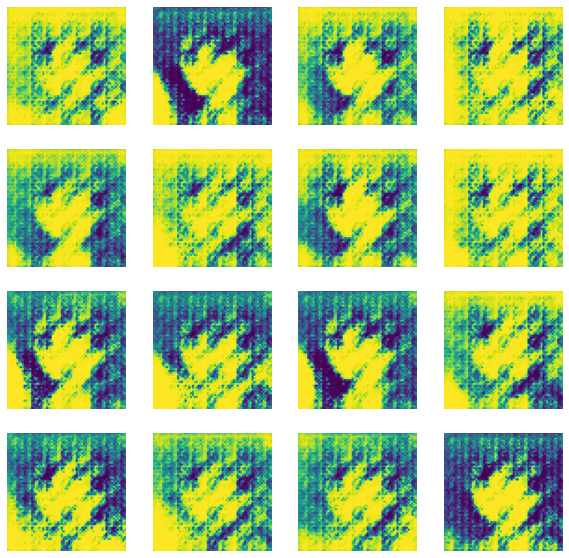

In [29]:
tf.profiler.experimental.server.start(6009)
# Train the model here
train(train_ds, EPOCHS)

In [22]:
# launching tensorboard locally
%load_ext tensorboard
%reload_ext tensorboard
%tensorboard --logdir {log_dir} --bind_all

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


In [21]:
from tensorboard import notebook
notebook.list()

Known TensorBoard instances:
  - port 6006: logdir logs/ (started 0:18:34 ago; pid 152)
  - port 6007: logdir .logs/ (started 0:27:30 ago; pid 128)


Restore the latest checkpoint.

In [25]:
checkpoint.restore(tf.train.latest_checkpoint(checkpoint_dir))

## Create a GIF


In [46]:
# Display a single image using the epoch number
def display_image(epoch_no):
    return PIL.Image.open('image_at_epoch_{:04d}.png'.format(epoch_no))

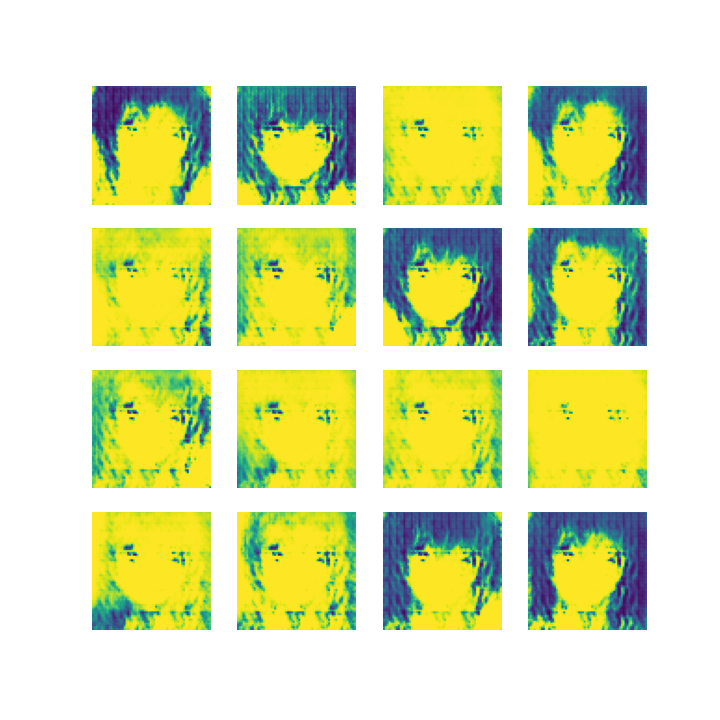

In [49]:
display_image(EPOCHS)

Use `imageio` to create an animated gif using the images saved during training.

In [50]:
anim_file = 'dcgan.gif'

with imageio.get_writer(anim_file, mode='I') as writer:
    
    filenames = glob.glob('image*.png')
    
    filenames = sorted(filenames)
    
    for filename in filenames:
        image = imageio.imread(filename)
        writer.append_data(image)
    
    image = imageio.imread(filename)
    
    writer.append_data(image)


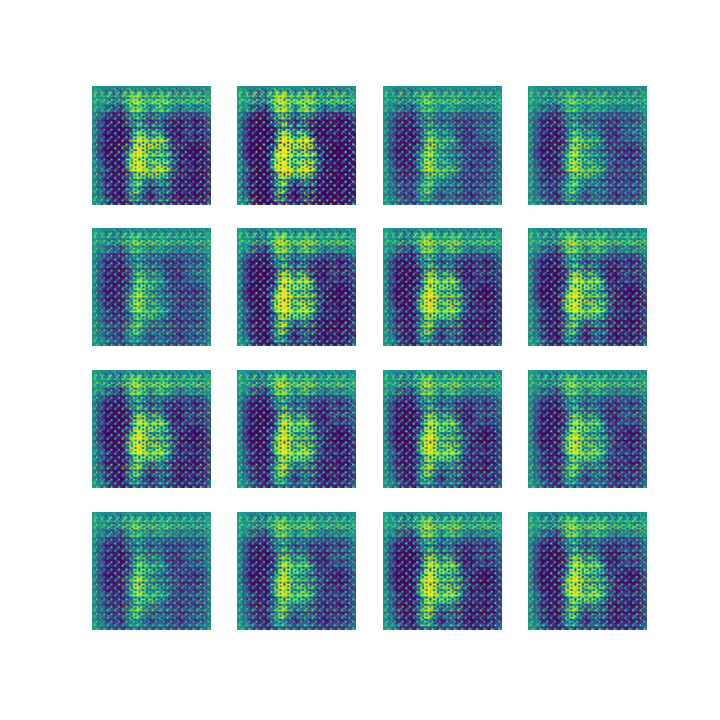

In [51]:
import tensorflow_docs.vis.embed as embed
embed.embed_file(anim_file)